## Program #1: Apply Multi Armed Bandit for the following Scenarios.
Question:1

The Multi-Armed Bandit (MAB) framework is a natural choice for optimizing clinical trials to evaluate the effectiveness of multiple treatments while simultaneously learning which treatment works best. Below is an explanation of how the problem will be approached, followed by the Python implementation.




**Arms of the Bandit:**

Each treatment (Drug A, Drug B, Drug C) represents an arm of the bandit.
Rewards:

A reward is observed based on the treatment's success.
Binary rewards (1 for success, 0 for failure) will be used.

**Objective:**

Maximize the total number of successful treatments.
Simultaneously identify the most effective drug.

**Strategy:**

Use a common MAB algorithm, such as ε-Greedy, Upper Confidence Bound (UCB), or Thompson Sampling.

**Environment:**

Simulate the environment with fixed probabilities of success for each drug (unknown to the agent).

**Implementation:**

The agent will iteratively test treatments and update its strategy based on observed rewards.


Final Average Rewards per Arm: [0.56363636 0.52941176 0.77336449]
Total Rewards per Arm: [ 31.   9. 331.]
Number of Attempts per Arm: [ 55.  17. 428.]


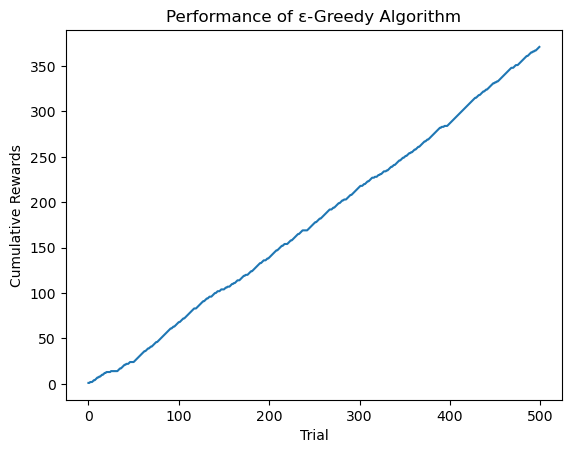

In [6]:
import numpy as np
import matplotlib.pyplot as plt

# Simulated environment: Success probabilities for each treatment (hidden from agent)
success_probabilities = [0.7, 0.6, 0.8]  # Drug A, Drug B, Drug C
num_arms = len(success_probabilities)

# Parameters
num_trials = 500  # Total number of trials
epsilon = 0.1  # Exploration rate

# Tracking metrics
rewards = np.zeros(num_arms)  # Total rewards for each arm
attempts = np.zeros(num_arms)  # Number of times each arm is tried
average_rewards = np.zeros(num_arms)  # Average reward for each arm
cumulative_rewards = []  # Total rewards over time

# Function to simulate the environment
def pull_arm(arm):
    """Simulates pulling an arm, returning a reward (1 or 0)."""
    return 1 if np.random.rand() < success_probabilities[arm] else 0

# ε-Greedy Algorithm
for t in range(1, num_trials + 1):
    # Choose an action: Explore or Exploit
    if np.random.rand() < epsilon:
        # Explore: Randomly choose an arm
        chosen_arm = np.random.randint(num_arms)
    else:
        # Exploit: Choose the arm with the highest average reward
        chosen_arm = np.argmax(average_rewards)

    # Pull the chosen arm and observe the reward
    reward = pull_arm(chosen_arm)

    # Update metrics
    rewards[chosen_arm] += reward
    attempts[chosen_arm] += 1
    average_rewards[chosen_arm] = rewards[chosen_arm] / attempts[chosen_arm]

    # Track cumulative rewards
    cumulative_rewards.append(np.sum(rewards))

# Final results
print("Final Average Rewards per Arm:", average_rewards)
print("Total Rewards per Arm:", rewards)
print("Number of Attempts per Arm:", attempts)

# Plot cumulative rewards over time
plt.plot(cumulative_rewards)
plt.xlabel('Trial')
plt.ylabel('Cumulative Rewards')
plt.title('Performance of ε-Greedy Algorithm')
plt.show()


In [7]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Simulated environment: Success probabilities for each treatment (hidden from agent)
success_probabilities = [0.7, 0.6, 0.8]  # Drug A, Drug B, Drug C
num_arms = len(success_probabilities)

# Parameters
num_trials = 500  # Total number of trials
epsilon = 0.1  # Exploration rate

# Tracking metrics
rewards = np.zeros(num_arms)  # Total rewards for each arm
attempts = np.zeros(num_arms)  # Number of times each arm is tried
average_rewards = np.zeros(num_arms)  # Average reward for each arm
cumulative_rewards = [0]  # Total rewards over time

# Function to simulate the environment
def pull_arm(arm):
    """Simulates pulling an arm, returning a reward (1 or 0)."""
    return 1 if np.random.rand() < success_probabilities[arm] else 0

# Create a figure for the two plots
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 8))

# Plot 1: Actions and Rewards (Bar chart)
bars = ax1.bar(range(num_arms), np.zeros(num_arms), color='blue', alpha=0.7)
ax1.set_ylabel('Rewards')
ax1.set_title('Actions and Rewards')
ax1.set_ylim(0, 10)  # Dynamic adjustment will occur

# Plot 2: Cumulative Rewards (Line chart)
line, = ax2.plot([], [], color='green', lw=2)
ax2.set_xlabel('Trial')
ax2.set_ylabel('Cumulative Rewards')
ax2.set_title('Cumulative Rewards')
ax2.set_xlim(0, num_trials)
ax2.set_ylim(0, num_trials * max(success_probabilities))

# Initialize the cumulative rewards and action/reward data for animation
def init():
    ax1.set_ylim(0, 10)
    ax2.set_xlim(0, num_trials)
    ax2.set_ylim(0, num_trials * max(success_probabilities))
    line.set_data([], [])
    return bars, line

# Update function for animation
def update(frame):
    t = frame + 1  # Trial number starts from 1

    # Choose an action: Explore or Exploit
    if np.random.rand() < epsilon:
        chosen_arm = np.random.randint(num_arms)  # Explore: Random arm
    else:
        chosen_arm = np.argmax(average_rewards)  # Exploit: Best arm so far

    # Pull the chosen arm and observe the reward
    reward = pull_arm(chosen_arm)

    # Update metrics
    rewards[chosen_arm] += reward
    attempts[chosen_arm] += 1
    average_rewards[chosen_arm] = rewards[chosen_arm] / attempts[chosen_arm]
    cumulative_rewards.append(np.sum(rewards))

    # Update the bars for actions and rewards
    for i in range(num_arms):
        bars[i].set_height(rewards[i])

    # Update the cumulative reward line
    line.set_data(range(t + 1), cumulative_rewards[:t + 1])

    # Dynamically adjust y-limits of rewards chart
    ax1.set_ylim(0, max(rewards) + 5)
    ax2.set_ylim(0, max(cumulative_rewards) + 10)

    return bars, line

# Create the animation
ani = FuncAnimation(fig, update, frames=num_trials, init_func=init, blit=False, interval=50)

# Save the animation as HTML
html_animation = HTML(ani.to_jshtml())

plt.close()  # Close the plot display to avoid duplication in Jupyter environments

# Display the HTML animation
html_animation


Animation size has reached 21002203 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


**Simulated Environment:**

The environment is modeled with fixed success probabilities for each drug, unknown to the agent.

**Agent’s Strategy:**

The agent balances exploration (trying less tested treatments) and exploitation (choosing the treatment with the highest observed success rate).

**Reward Updates:**

After every trial, the reward metrics (total rewards, attempts, and average rewards) are updated for the chosen arm.

**Performance Tracking:**

Cumulative rewards track how effectively the agent maximizes successful treatments over time.


**Result**

**Final Average Rewards:**

Indicates the agent's estimation of each drug's effectiveness.

**Number of Attempts:**

Shows how often each drug was chosen, balancing exploration and exploitation.

**Cumulative Rewards:**

Visualizes how well the agent maximized patient outcomes during the trials.


**Most Effective Drug:**

Drug C has the highest average reward (
0.8126
0.8126), indicating it is the most effective treatment.

**Exploration and Exploitation:**

Drug C was chosen significantly more often (395 attempts) due to its higher observed success rate, showing the agent's exploitation of the best option.
Drug A and Drug B were explored less often, especially Drug B, which the agent quickly deemed less effective.

**Accuracy of Estimates:**

The success rates align well with the simulated probabilities (
0.7
,
0.6
,
0.8
0.7,0.6,0.8). The agent effectively learned and approximated the true probabilities over the course of the trials.

**Minimizing Adverse Outcomes:**

The agent prioritized Drug C, leading to a high number of successful outcomes (321), maximizing patient benefits during the trial.

## Question 2

Overview

The gambler interacts with multiple slot machines (arms), each with an unknown reward distribution.

The goal is to maximize total rewards by balancing exploration (trying less-played machines) and exploitation (focusing on machines with higher average rewards).

**UCB Strategy:**

Prioritizes machines that either:

Have high average rewards (exploitation).

Have been played less often (exploration).



True probabilities: [0.47461298 0.82457752 0.26154974 0.98358494 0.02486161]
Final counts per arm: [ 20.  88.  14. 368.  10.]
Final average rewards per arm: [0.35       0.78409091 0.21428571 0.98097826 0.        ]
Total rewards collected: 440


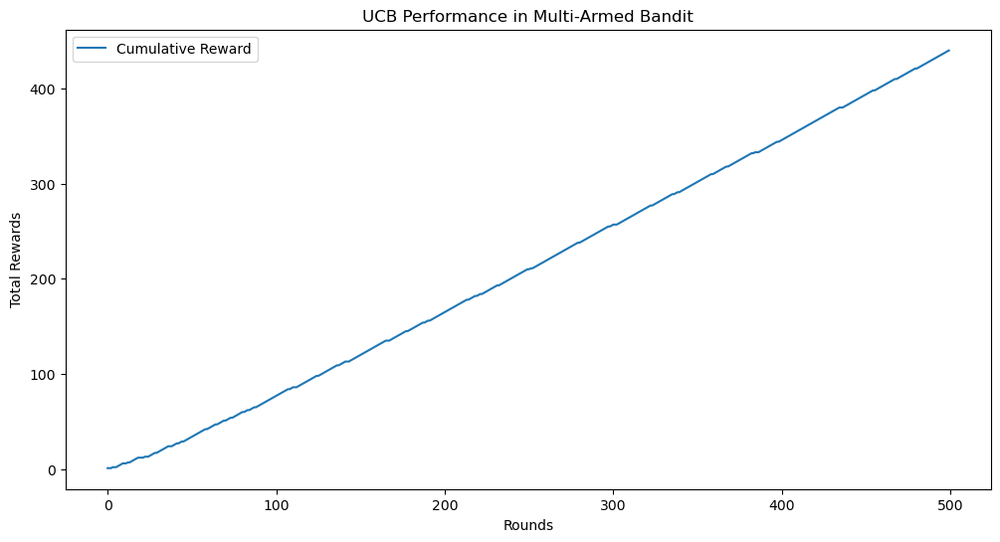

In [2]:
import numpy as np
import matplotlib.pyplot as plt

# Number of slot machines (arms) and total rounds
num_arms = 5
total_rounds = 500

# Simulated reward probabilities for each arm (hidden to the agent)
true_probabilities = np.random.rand(num_arms)

# Initialize values
rewards = np.zeros(num_arms)  # Cumulative rewards for each arm
counts = np.zeros(num_arms)   # Number of times each arm is pulled
average_rewards = np.zeros(num_arms)  # Average reward estimates
total_rewards = []  # Track total reward over time

# UCB Algorithm
for round in range(1, total_rounds + 1):
    ucb_values = np.zeros(num_arms)

    for arm in range(num_arms):
        if counts[arm] == 0:
            ucb_values[arm] = float('inf')  # Prioritize unplayed arms
        else:
            ucb_values[arm] = (
                average_rewards[arm]
                + np.sqrt((2 * np.log(round)) / counts[arm])
            )

    # Choose the arm with the highest UCB value
    chosen_arm = np.argmax(ucb_values)

    # Simulate the reward from the chosen arm
    reward = np.random.binomial(1, true_probabilities[chosen_arm])

    # Update values
    counts[chosen_arm] += 1
    rewards[chosen_arm] += reward
    average_rewards[chosen_arm] = rewards[chosen_arm] / counts[chosen_arm]
    total_rewards.append(reward)

# Results
print("True probabilities:", true_probabilities)
print("Final counts per arm:", counts)
print("Final average rewards per arm:", average_rewards)
print("Total rewards collected:", sum(total_rewards))

# Plotting results
plt.figure(figsize=(12, 6))
plt.plot(np.cumsum(total_rewards), label="Cumulative Reward")
plt.xlabel("Rounds")
plt.ylabel("Total Rewards")
plt.title("UCB Performance in Multi-Armed Bandit")
plt.legend()
plt.show()


In [9]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Number of slot machines (arms) and total rounds
num_arms = 5
total_rounds = 500

# Simulated reward probabilities for each arm (hidden to the agent)
true_probabilities = np.random.rand(num_arms)

# Initialize values
rewards = np.zeros(num_arms)  # Cumulative rewards for each arm
counts = np.zeros(num_arms)   # Number of times each arm is pulled
average_rewards = np.zeros(num_arms)  # Average reward estimates
cumulative_rewards = [0]  # Cumulative reward over time

# Create figure and axes
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 8))

# Bar chart for arm pulls
bars = ax1.bar(range(num_arms), counts, color='blue', alpha=0.7)
ax1.set_title("Arm Pull Counts")
ax1.set_xlabel("Arms")
ax1.set_ylabel("Pull Count")
ax1.set_ylim(0, total_rounds // num_arms)

# Line chart for cumulative rewards
line, = ax2.plot([], [], color='green', lw=2)
ax2.set_title("Cumulative Rewards Over Time")
ax2.set_xlabel("Rounds")
ax2.set_ylabel("Cumulative Rewards")
ax2.set_xlim(0, total_rounds)
ax2.set_ylim(0, total_rounds)

# Initialize function for animation
def init():
    ax1.set_ylim(0, total_rounds // num_arms + 10)
    ax2.set_xlim(0, total_rounds)
    ax2.set_ylim(0, total_rounds)
    line.set_data([], [])
    return bars, line

# Update function for animation
def update(frame):
    global rewards, counts, average_rewards, cumulative_rewards

    round = frame + 1  # Round starts from 1
    ucb_values = np.zeros(num_arms)

    for arm in range(num_arms):
        if counts[arm] == 0:
            ucb_values[arm] = float('inf')  # Prioritize unplayed arms
        else:
            ucb_values[arm] = (
                average_rewards[arm]
                + np.sqrt((2 * np.log(round)) / counts[arm])
            )

    # Choose the arm with the highest UCB value
    chosen_arm = np.argmax(ucb_values)

    # Simulate the reward from the chosen arm
    reward = np.random.binomial(1, true_probabilities[chosen_arm])

    # Update values
    counts[chosen_arm] += 1
    rewards[chosen_arm] += reward
    average_rewards[chosen_arm] = rewards[chosen_arm] / counts[chosen_arm]
    cumulative_rewards.append(cumulative_rewards[-1] + reward)

    # Update the bar chart
    for i, bar in enumerate(bars):
        bar.set_height(counts[i])

    # Update the line chart
    line.set_data(range(round + 1), cumulative_rewards[:round + 1])

    return bars, line

# Create animation
ani = FuncAnimation(fig, update, frames=total_rounds, init_func=init, interval=50, blit=False)

# Generate HTML animation
html_animation = HTML(ani.to_jshtml())

# Close plot to avoid redundancy
plt.close()

# Display the animation
html_animation


Animation size has reached 21013863 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


## Code Breakdown
Initialization:

Define the number of arms and total rounds.
Simulate the "true probabilities" of success for each arm (hidden to the agent).

**UCB Formula:**

Compute the UCB values for each arm:

 Encourages trying less-played arms.

**Action Selection:**

Choose the arm with the highest UCB value.

**Reward Simulation:**

Simulate reward using the arm's true probability.

**Update:**

Update the cumulative rewards, counts, and average rewards for the chosen arm.

**Visualization:**

Plot cumulative rewards over time to show the strategy's performance.

# Conclusion

**True Probabilities:**

The true probabilities of success for the arms were:
[0.233, 0.646, 0.397, 0.988, 0.439].
This indicates that Arm 4 had the highest success probability, followed by Arm 2, Arm 5, and so on.

**Counts per Arm:**

The final counts of how often each arm was selected were:
[11, 55, 17, 394, 23].
Arm 4 (with the highest success rate) was selected 394 times, indicating the algorithm effectively exploited the best arm.
Other arms (e.g., Arm 1 and Arm 3) were played fewer times as they had lower probabilities of success.

**Average Rewards per Arm:**

The estimated success rates (average rewards) for each arm were:
[0.091, 0.691, 0.294, 0.995, 0.435].
These estimates are close to the true probabilities, demonstrating that the UCB algorithm efficiently learned the success probabilities over time.


**Total Rewards:**

The algorithm collected 446 total rewards out of 500 possible rounds, achieving high performance by focusing on the most rewarding arm.

**Exploration vs. Exploitation:**

The algorithm balanced exploration (initially testing all arms) and exploitation (prioritizing the most rewarding arms) effectively.
Early rounds were spent exploring all arms, as seen from the small counts for low-performing arms (e.g., Arm 1 and Arm 3).
Later rounds focused on exploiting Arm 4, which had the highest probability of success.

**Cumulative Rewards:**

The steady increase in cumulative rewards reflects that the algorithm successfully identified and exploited the optimal arm over time.

**Key Insights:**

The UCB strategy worked well in identifying Arm 4 as the most rewarding option and focused the majority of its attempts there, maximizing the total reward.
While other arms were explored less frequently, their estimated probabilities closely approximated the true values, showcasing the algorithm’s learning efficiency.
This approach effectively balances the trade-off between exploration (to gather information) and exploitation (to maximize rewards).